# 2. Data Understanding


## 2.1 Collecting Initial Data

Import the Python libraries we need.

In [1]:
import os
import skimage as si
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from skimage import io, measure

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

### Step 1 - Load Images
First, we need to load in our training dataset with all images and label them. In the `/dataset-images/` there are 10 subdirectories, each containing images of a different class. We will load all images and their labels into a pandas dataframe.

In [2]:
directory = "../dataset-images"
# get the name of each subdirectory in the directory
digit_labels = [subdir for subdir in os.listdir(directory) if os.path.isdir(os.path.join(directory, subdir))]
images = [] # list of images as tuple where first element is the image and second element is the label

for label in digit_labels:
    dir = os.path.join(directory, label)
    for filename in os.listdir(dir):
        img = io.imread(os.path.join(dir, filename))
        images.append((img, label))

# Print image statistics
print("Number of images:", len(images))

Number of images: 42000


### Step 2 - Analyze Initial Data

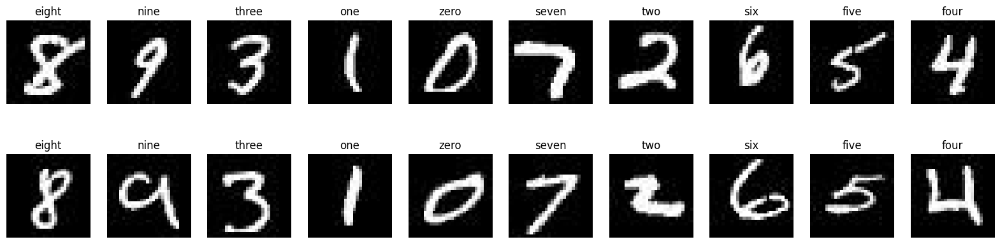

In [3]:
# print 2 examples of each digit
fig, ax = plt.subplots(2, 10, figsize=(20, 5))
for i in range(10):
    for j in range(2):
        ax[j, i].imshow([img for img, label in images if label == digit_labels[i]][j], cmap='gray')
        ax[j, i].set_title(digit_labels[i])
        ax[j, i].axis('off')
plt.show()

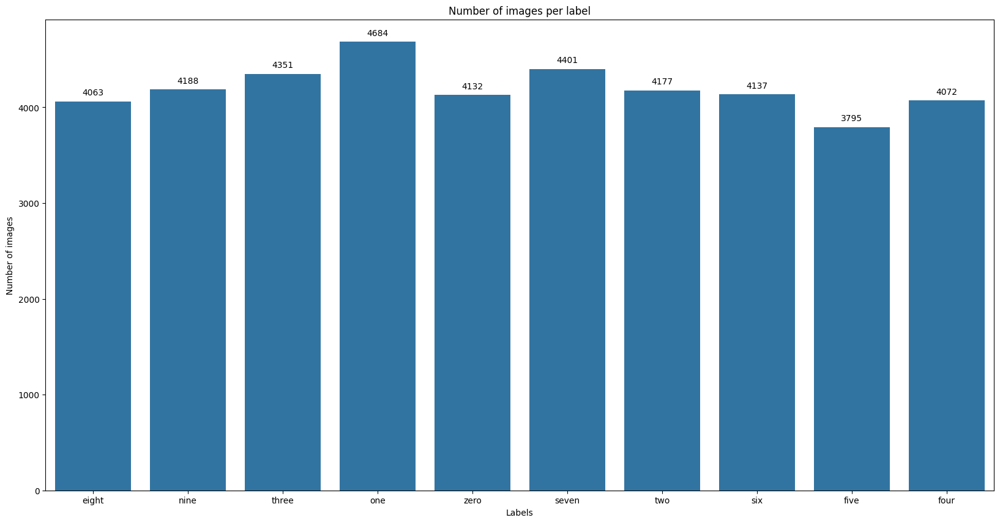

In [4]:
fig, ax = plt.subplots(figsize=(20, 10))
ax.set_title("Number of images per label")
ax.set_xlabel("Labels")
ax.set_ylabel("Number of images")

sns.countplot(x=[label for _, label in images], ax=ax)

# Annotate each bar with the count
for p in ax.patches:
    height = int(p.get_height())
    ax.annotate(f'{height}', (p.get_x() + p.get_width() / 2., height), 
                ha='center', va='center', xytext=(0, 10), textcoords='offset points')

### Step 3 - Feature Extraction

In [5]:
def pad_arrays_to_same_shape(arr1, arr2):
    """Make arrays the same same shape

    If `arr1` or `arr2` are not of the same shape, this function will pad the smaller array to match the shape of the bigger one.
    """
    # Get the shapes of the arrays
    shape1 = np.shape(arr1)
    shape2 = np.shape(arr2)

    # If the shapes are not the same, pad the smaller array with zeros
    if shape1 != shape2:
        # Determine which array is smaller
        if shape1[0] < shape2[0]:
            # Pad arr1 with zeros
            arr1 = np.pad(arr1, ((0, shape2[0] - shape1[0]), (0, 0)), 'constant', constant_values=(0))
        elif shape1[0] > shape2[0]:
            # Pad arr2 with zeros
            arr2 = np.pad(arr2, ((0, shape1[0] - shape2[0]), (0, 0)), 'constant', constant_values=(0))

        if shape1[1] < shape2[1]:
            # Pad arr1 with zeros
            arr1 = np.pad(arr1, ((0, 0), (0, shape2[1] - shape1[1])), 'constant', constant_values=(0))
        elif shape1[1] > shape2[1]:
            # Pad arr2 with zeros
            arr2 = np.pad(arr2, ((0, 0), (0, shape1[1] - shape2[1])), 'constant', constant_values=(0))
    
    return arr1, arr2

In [6]:
def crop_img(img):
    """Crop the image to where black pixels can be found

    This function makes sure that each image is cropped down to the number's dimension.
    """
     # find the first black pixel from the left
    left = 0
    for i in range(img.shape[1]):
        if np.any(img[:, i] == 0):
            left = i
            break
    # find the first black pixel from the right
    right = 0
    for i in reversed(range(img.shape[1])):
        if np.any(img[:, i] == 0):
            right = i
            break
    # find the first black pixel from the top
    top = 0
    for i in range(img.shape[0]):
        if np.any(img[i, :] == 0):
            top = i
            break
    # find the first black pixel from the bottom
    bottom = 0
    for i in reversed(range(img.shape[0])):
        if np.any(img[i, :] == 0):
            bottom = i
            break
    # crop the image to the smallest rectangle containing the image
    cropped_img = img[top:bottom+1, left:right+1]
    return cropped_img

In [7]:
def h_v_symmetry_errors(img_symmetry):
    """Calculate the horizontal and vertical symmetry error rate of an image

    This function returns a tuple of 2 floats: `(horizontal_sym_errors, vertical_sym_errors)`

    Each returned number is a percentage of errors on how many pixels are not symmetric. 1 means the image not symmetric at all (100% errors)
    and 0 means every pixel is symmetric (0% errors)
    """
    middle_horizontal = img_symmetry.shape[0] // 2
    middle_vertical = img_symmetry.shape[1] // 2
    # check if the image is horizontally symmetric
    top = img_symmetry[:middle_horizontal, :]
    bottom = np.flip(img_symmetry[middle_horizontal:, :], axis=0)
    # check if the shape is the same for top and bottom and if not, insert rows of zeros
    top, bottom = pad_arrays_to_same_shape(top, bottom)
    result = top ^ bottom
    sum_result = np.sum(result) / (result.shape[0] * result.shape[1])
    horizontal_sym_errors = sum_result
    # check if the image is vertically symmetric
    left = img_symmetry[:, :middle_vertical]
    right = np.flip(img_symmetry[:, middle_vertical:], axis=1)
    # check if the shape is the same for left and right and if not, insert columns of zeros
    left, right = pad_arrays_to_same_shape(left, right)
    result = left ^ right
    sum_result = np.sum(result) / (result.shape[0] * result.shape[1])
    vertical_sym_errors = sum_result
    
    return horizontal_sym_errors, vertical_sym_errors

In [8]:
def count_black_pixels(img, regions=1):
    """Count the amount of black pixels in an image

    An optional `regions` may be set to count the black pixels for different regions (grids) of the original image

    This function returns an array of each defined grid's (default 1) summed black pixels
    """
    # split the image into a grids
    img_split = np.array_split(img, regions)
    # get plack pixels for each grid
    black_pixels = []
    for i in range(regions):
        for j in range(regions):
            black_pixels.append(np.sum(img_split[i][j] == 0))
    return black_pixels

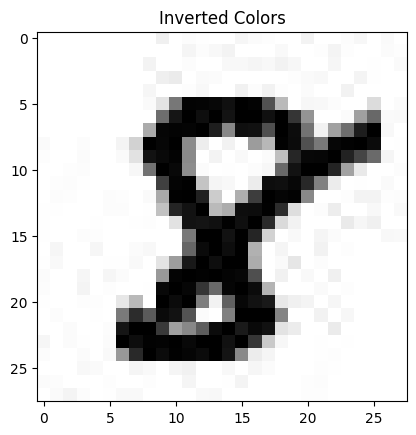

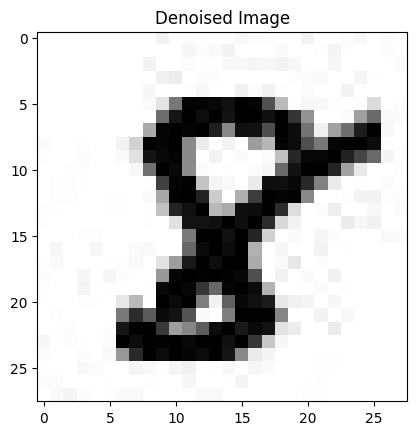

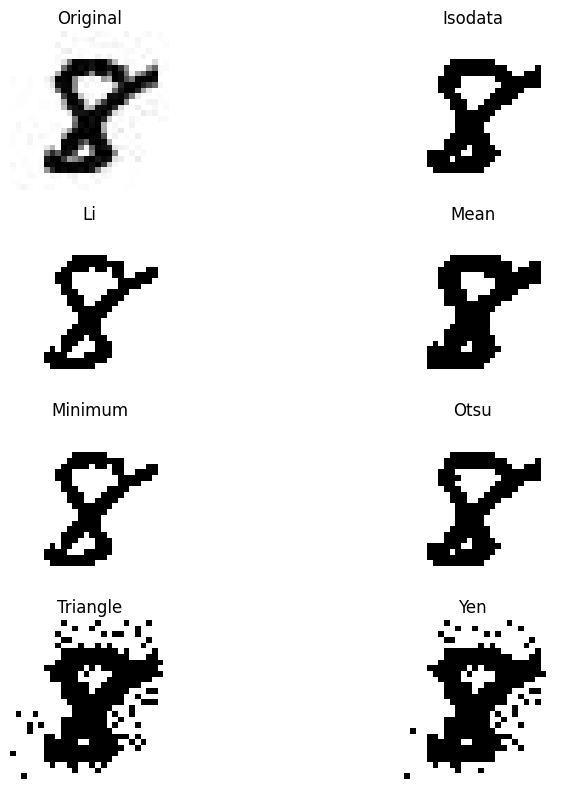

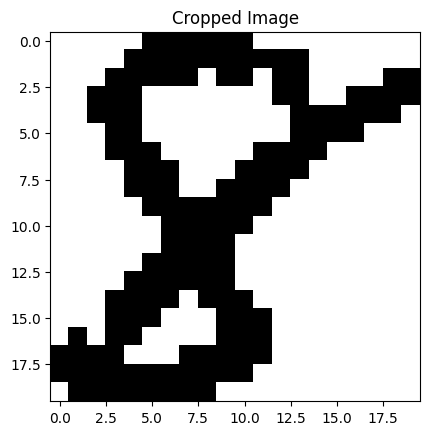

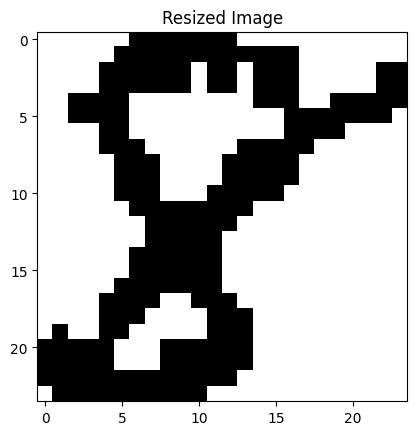

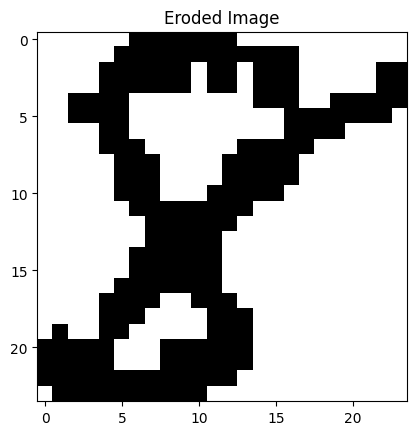

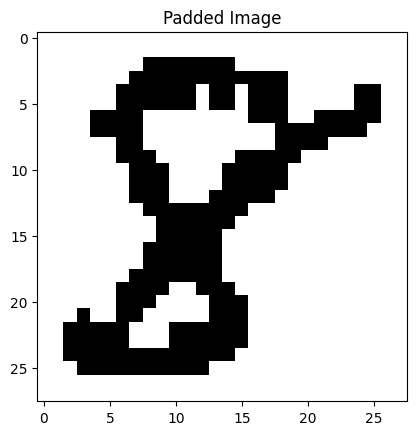

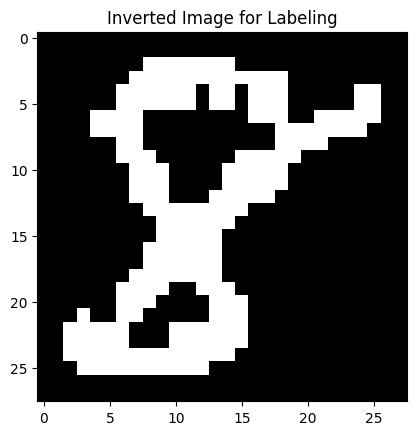

               area   area_filled   area_convex  axis_major_length  \
count  42000.000000  42000.000000  42000.000000       42000.000000   
mean     198.378214    224.449024    389.734643          30.201964   
std       62.421688     88.333802     79.380182           3.794475   
min        1.000000      1.000000      1.000000           0.000000   
25%      159.000000    162.000000    361.000000          28.134902   
50%      192.000000    206.000000    399.000000          30.356730   
75%      230.000000    270.000000    438.000000          32.584134   
max      576.000000    576.000000    576.000000          40.574068   

       axis_minor_length  eccentricity  equivalent_diameter_area  \
count       42000.000000  42000.000000              42000.000000   
mean           19.233570      0.716395                 15.686753   
std             5.096191      0.168981                  2.551261   
min             0.000000      0.000000                  1.128379   
25%            17.081622     

In [9]:
extracted_features = []
processed_images = []
printed = False

for img, label in images:
    # if the image is not RGB, convert it
    if len(img.shape) == 2:
        img = si.color.gray2rgb(img)
    
    # remove the alpha channel
    img = img[:, :, :3]

    # since our image has initially black background and white numbers, we need to flip the colors
    img = np.invert(img.copy())
    if label == "eight" and not printed:
        plt.imshow(img)
        plt.title("Inverted Colors")
        plt.show()

    # binary color scale
    img = si.color.rgb2gray(img)

    # Denoise the image
    img = si.filters.gaussian(img, sigma=0.3)

    if label == "eight" and not printed:
        plt.imshow(img, cmap='gray')
        plt.title("Denoised Image")
        plt.show()

        fig, ax = si.filters.try_all_threshold(img, figsize=(10, 8), verbose=False)
        plt.show()

    threshold_value = si.filters.threshold_li(img)
    img = img > threshold_value

    # Crop the image to where the numbers can be found so we can resize the number to full size
    img = crop_img(img)
    if label == "eight" and not printed:
        plt.imshow(img, cmap='gray')
        plt.title("Cropped Image")
        plt.show()

    # Resize the cropped image to 28x28
    img = si.transform.resize(img, (24, 24)) # not 28x28 because of the padding for 2 pixels border we add later
    if label == "eight" and not printed:
        plt.imshow(img, cmap='gray')
        plt.title("Resized Image")
        plt.show()

    # Check if the image is horizontally symmetric
    horizontal_sym_errors, vertical_sym_errors = h_v_symmetry_errors(img.copy())

    # Apply erosion
    img = si.morphology.binary_erosion(img, si.morphology.square(1))
    if label == "eight" and not printed:
        plt.imshow(img, cmap='gray')
        plt.title("Eroded Image")
        plt.show()

    # add a 2 pixel white border around img to get correct hole count
    img = np.pad(img, ((2, 2), (2, 2)), 'constant', constant_values=(1))
    if label == "eight" and not printed:
        plt.imshow(img, cmap='gray')
        plt.title("Padded Image")
        plt.show()

    # get black pixel count for 3 x 3 sections of the img
    black_pixels = count_black_pixels(img, 3)

    # Flip colors to get the inverted image so the labeling will work on the drawn number
    img_inverted = np.invert(img.copy())
    if label == "eight" and not printed:
        plt.imshow(img_inverted, cmap='gray')
        plt.title("Inverted Image for Labeling")
        plt.show()

    # Label connected components in the binary image
    labeled_image_inverted = measure.label(img_inverted.astype(int))
    labeled_image = measure.label(img.astype(int))

    # Extract features from the labeled regions
    props_inverted = measure.regionprops(labeled_image_inverted)
    props = measure.regionprops(labeled_image)

    # Iterate through labeled regions and extract features from the first region
    if len(props_inverted) > 0: # if there are no regions, that means that the image has no drawing in it, we can thus ignore the else block
        first_region = props_inverted[0]
        features = { # all our extracted features
            # ---- Region prop features ----
            "label": label,
            "area": first_region.area,
            "area_filled": first_region.area_filled,
            "area_convex": first_region.area_convex,
            "axis_major_length": first_region.axis_major_length,
            "axis_minor_length": first_region.axis_minor_length,
            "eccentricity": first_region.eccentricity,
            "equivalent_diameter_area": first_region.equivalent_diameter_area,
            "extent": first_region.extent,
            "feret_diameter_max": first_region.feret_diameter_max,
            "perimeter": first_region.perimeter,
            "solidity": first_region.solidity,
            "holes": len(props)-1,
            # ---- Smart features ----
            "h_sym_err_percent": horizontal_sym_errors,
            "v_sym_err_percent": vertical_sym_errors,
            "pixelsum_tl": black_pixels[0],
            "pixelsum_tm": black_pixels[1],
            "pixelsum_tr": black_pixels[2],
            "pixelsum_ml": black_pixels[3],
            "pixelsum_mm": black_pixels[4],
            "pixelsum_mr": black_pixels[5],
            "pixelsum_bl": black_pixels[6],
            "pixelsum_bm": black_pixels[7],
            "pixelsum_br": black_pixels[8]
        }
        extracted_features.append((features))
        processed_images.append((img, label))
        if label == "eight" and not printed:
            printed = True

features_df = pd.DataFrame(extracted_features)

print(features_df.describe())

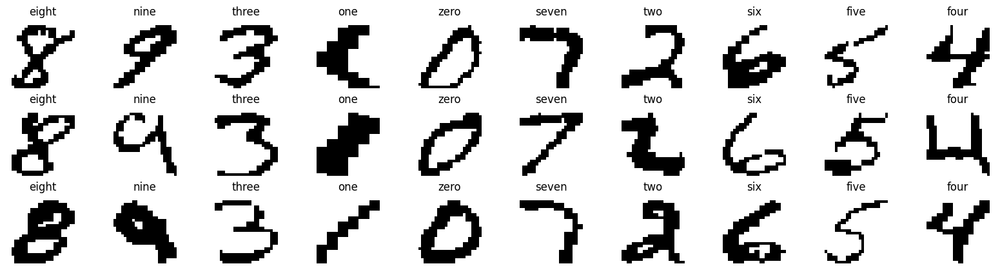

In [10]:
# print the processed images showing num_samples of each digit
num_samples = 3
fig, ax = plt.subplots(num_samples, 10, figsize=(20, 5))
for i in range(10):
    for j in range(num_samples):
        ax[j, i].imshow([img for img, label in processed_images if label == digit_labels[i]][j], cmap='gray')
        ax[j, i].set_title(digit_labels[i])
        ax[j, i].axis('off')
plt.show()

In [11]:
directory = "../dataset-numpy/" 
path = os.path.join(directory, 'features.csv')

features_df.to_csv(path, index=False)

## 2.2 Describing, Exploring and Verifying Data

In [12]:
# load features from csv
directory = "../dataset-numpy/"

dataset = pd.read_csv(os.path.join(directory, 'features.csv'), delimiter=',', header=0)

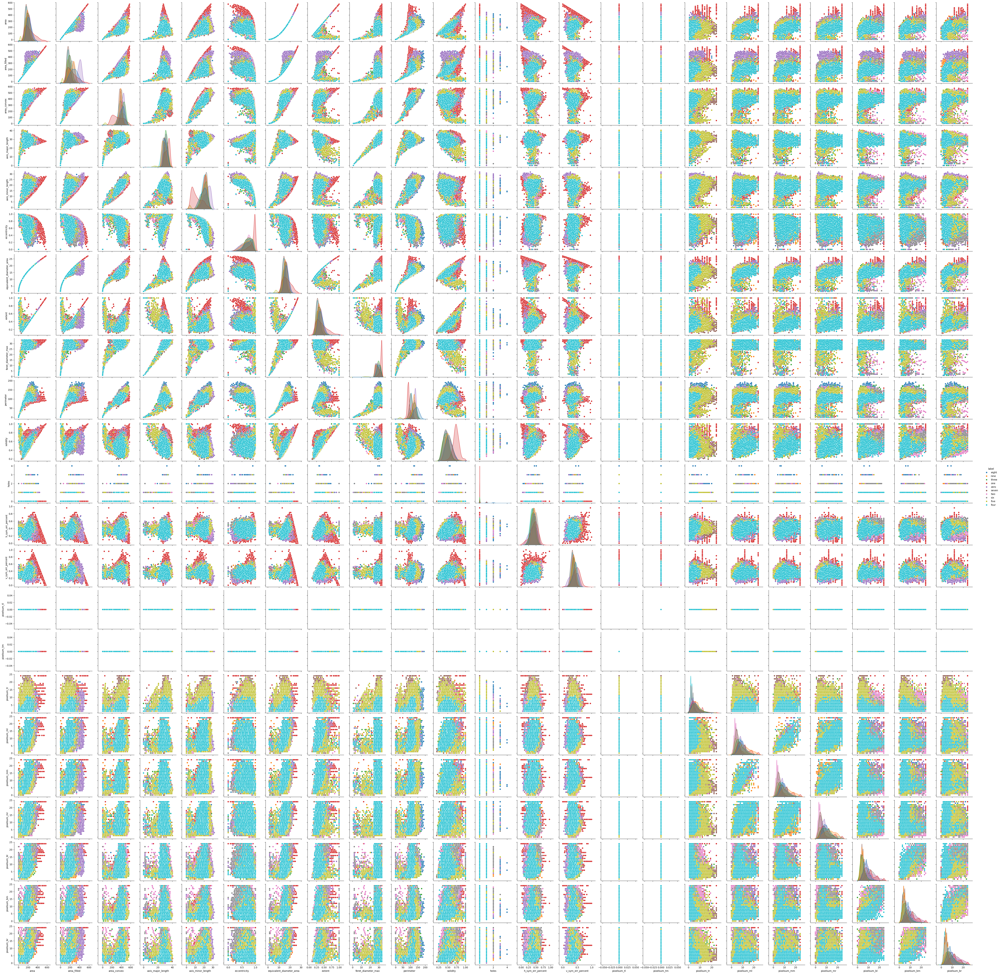

In [13]:
sns.pairplot(dataset, hue="label")

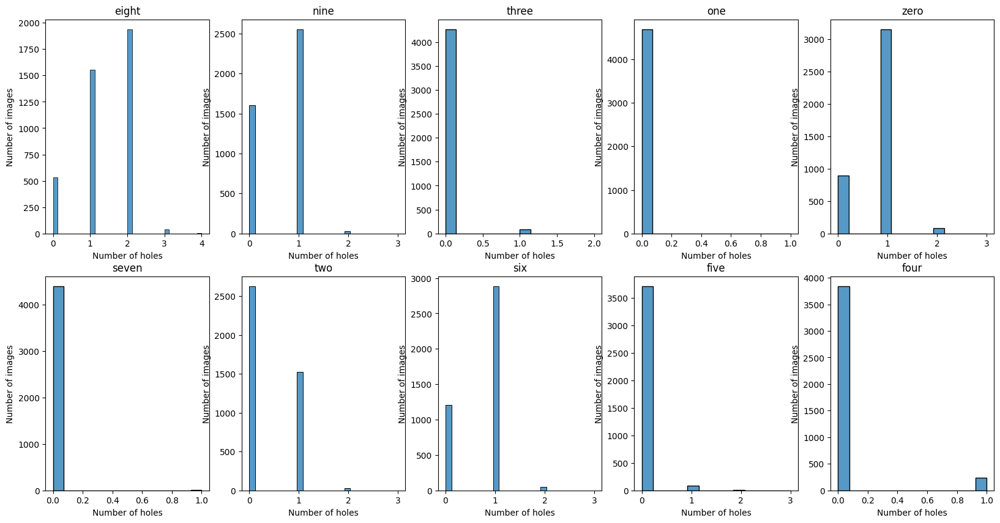

In [14]:
# Print the number of holes for each digit using histograms.
fig, ax = plt.subplots(2, 5, figsize=(20, 10))
for i in range(10):
    sns.histplot(dataset[dataset['label'] == digit_labels[i]]['holes'], ax=ax[i//5, i%5], kde=False)
    ax[i//5, i%5].set_title(digit_labels[i])
    ax[i//5, i%5].set_xlabel("Number of holes")
    ax[i//5, i%5].set_ylabel("Number of images")
plt.show()

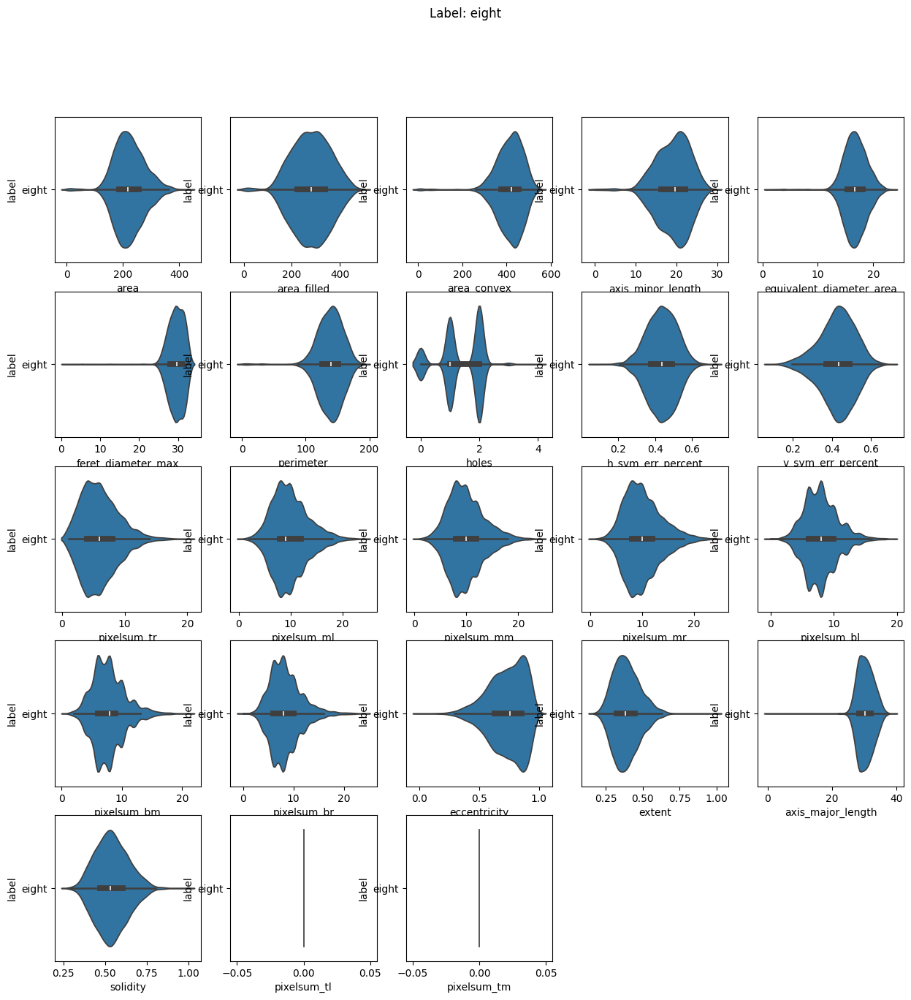

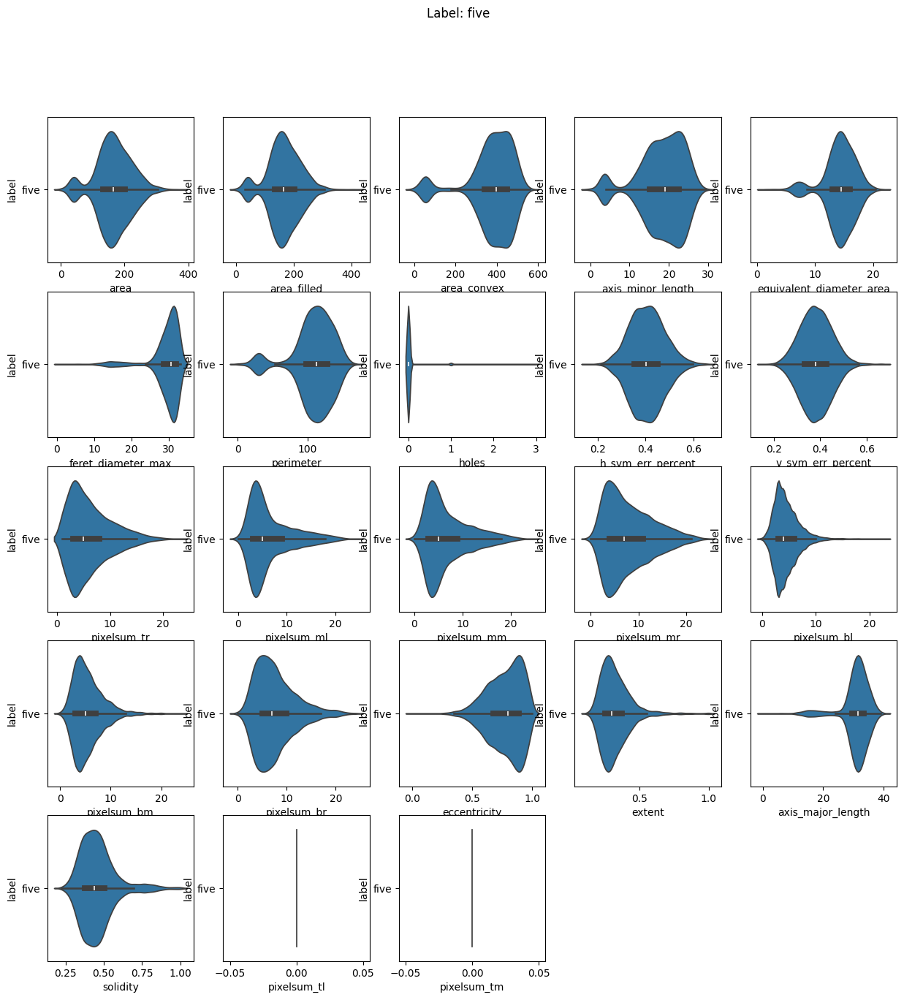

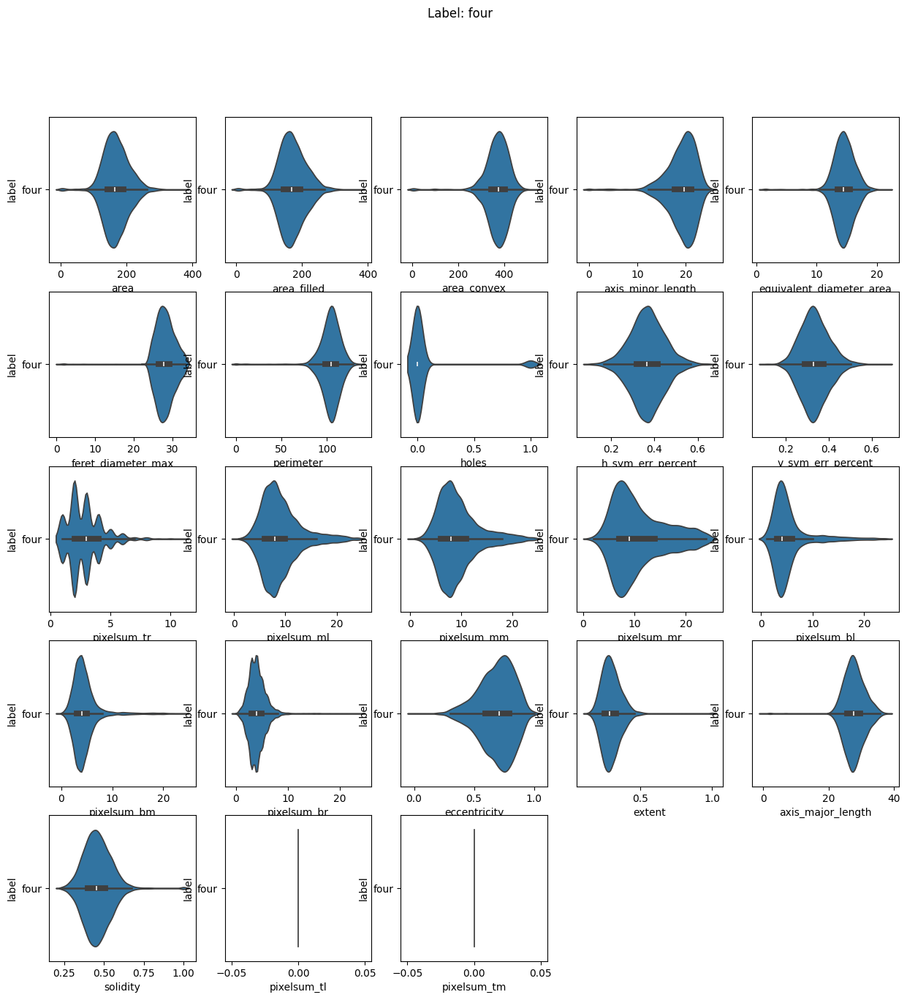

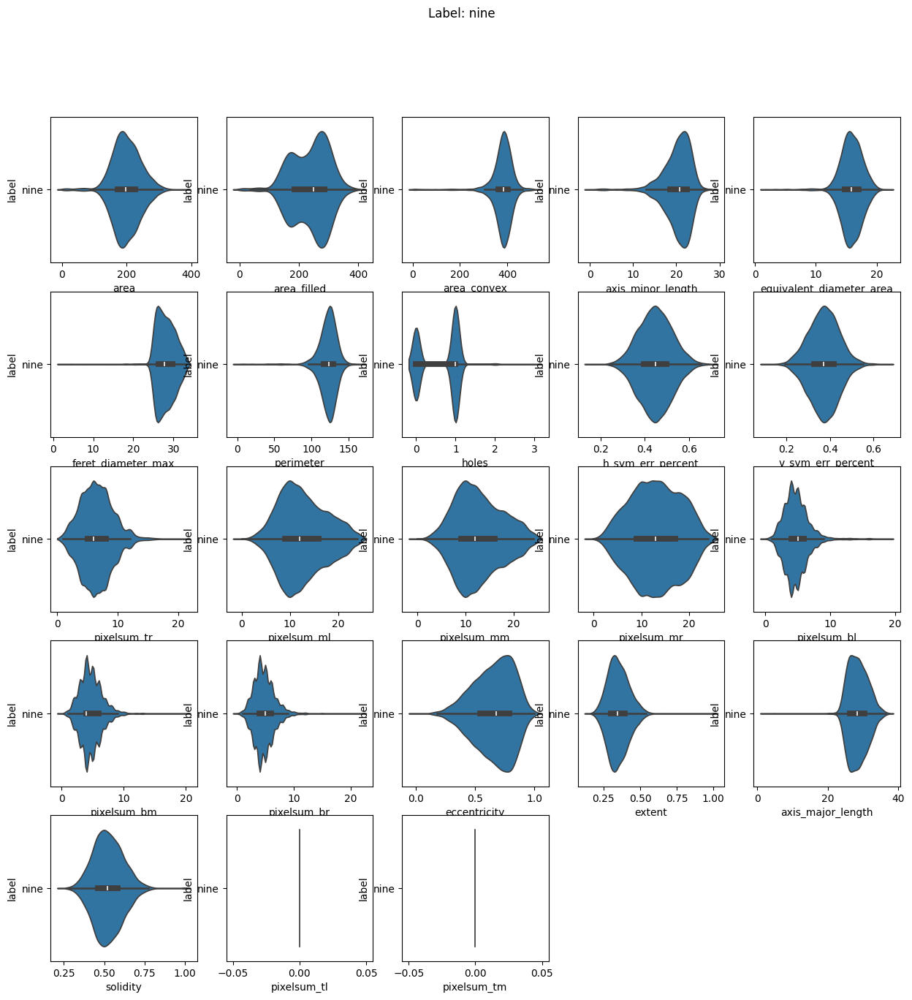

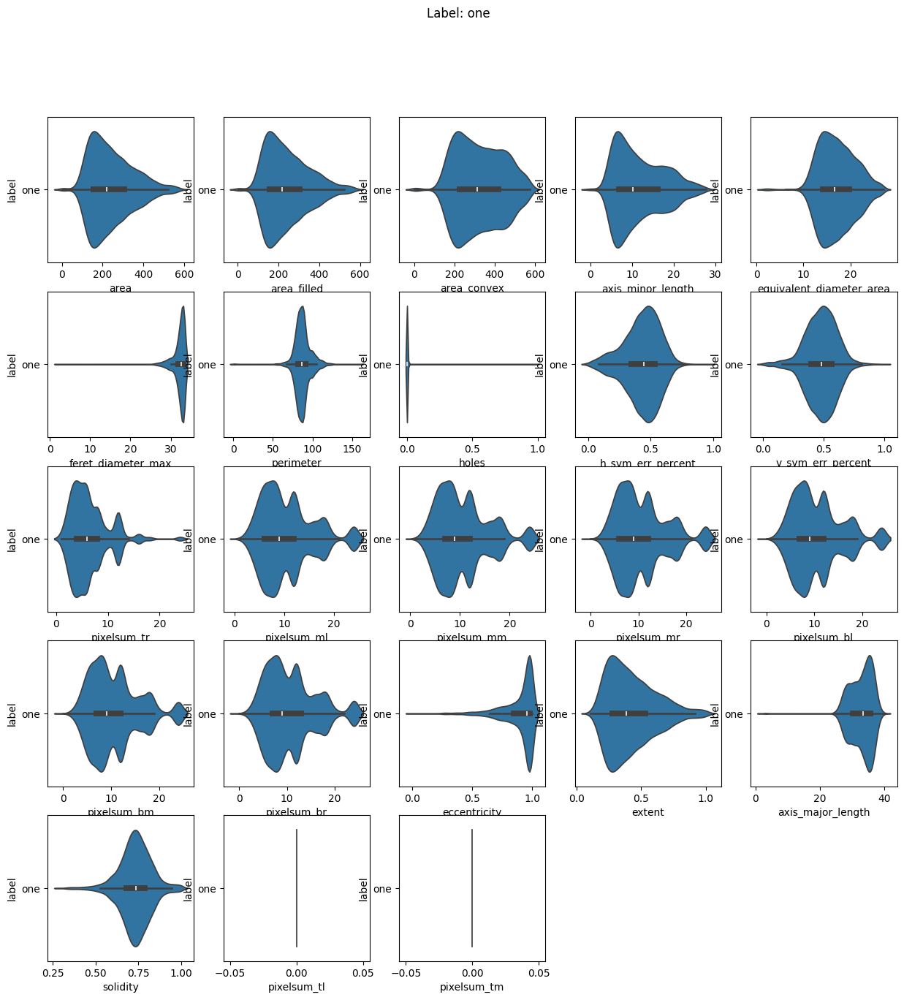

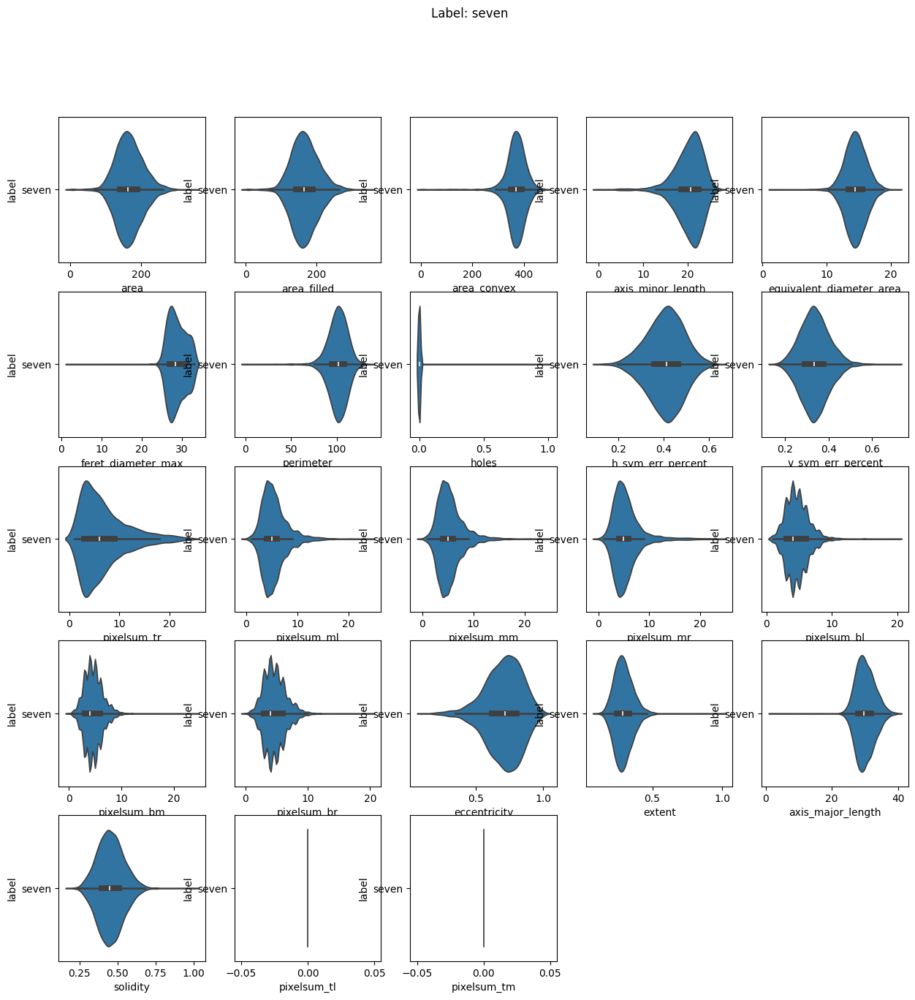

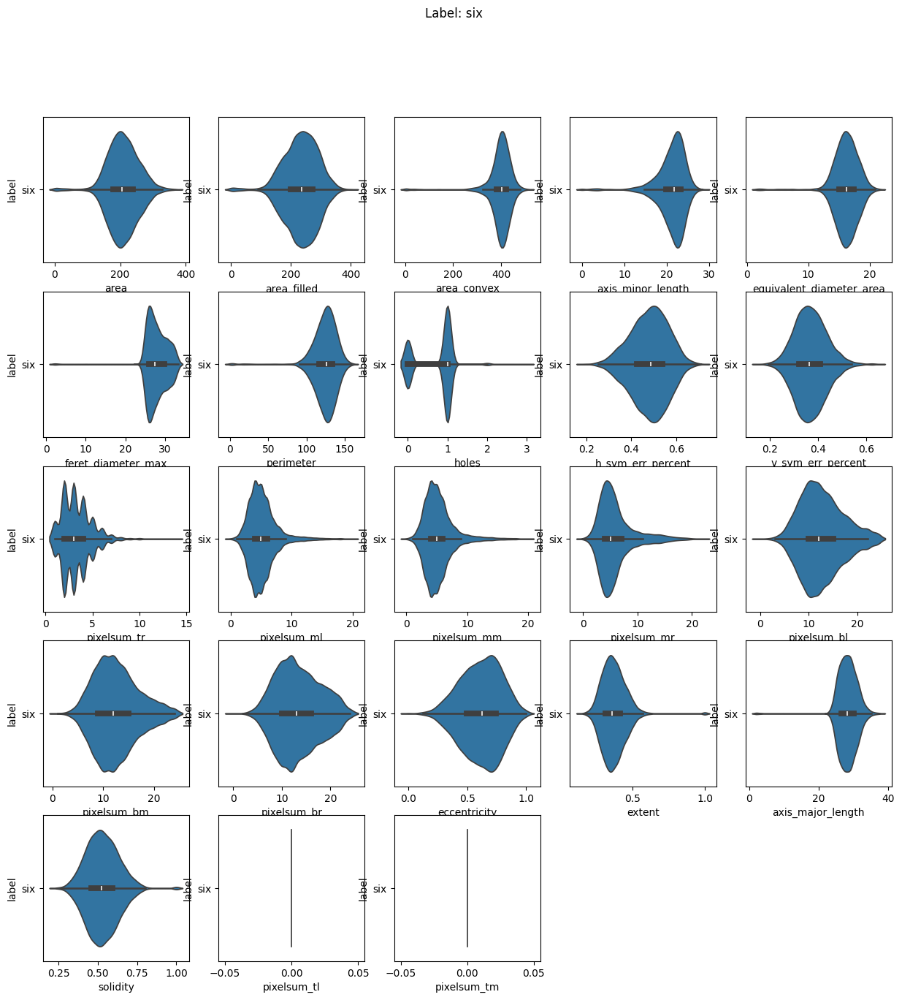

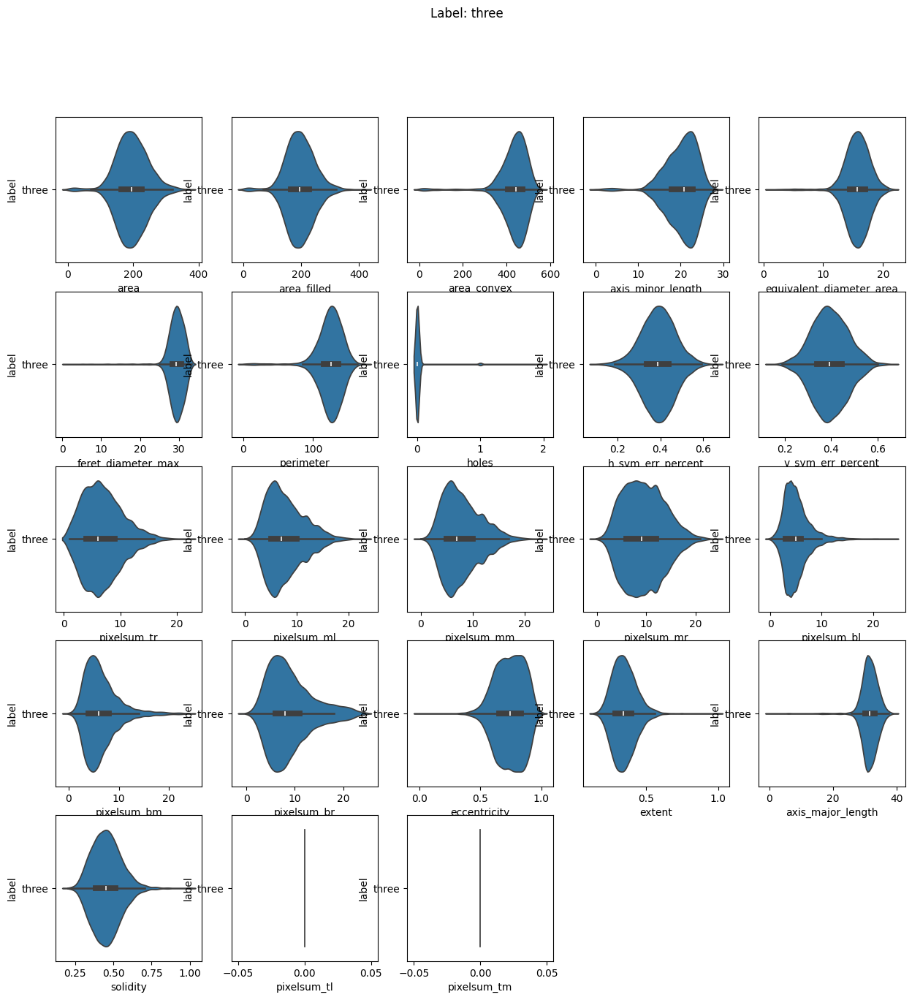

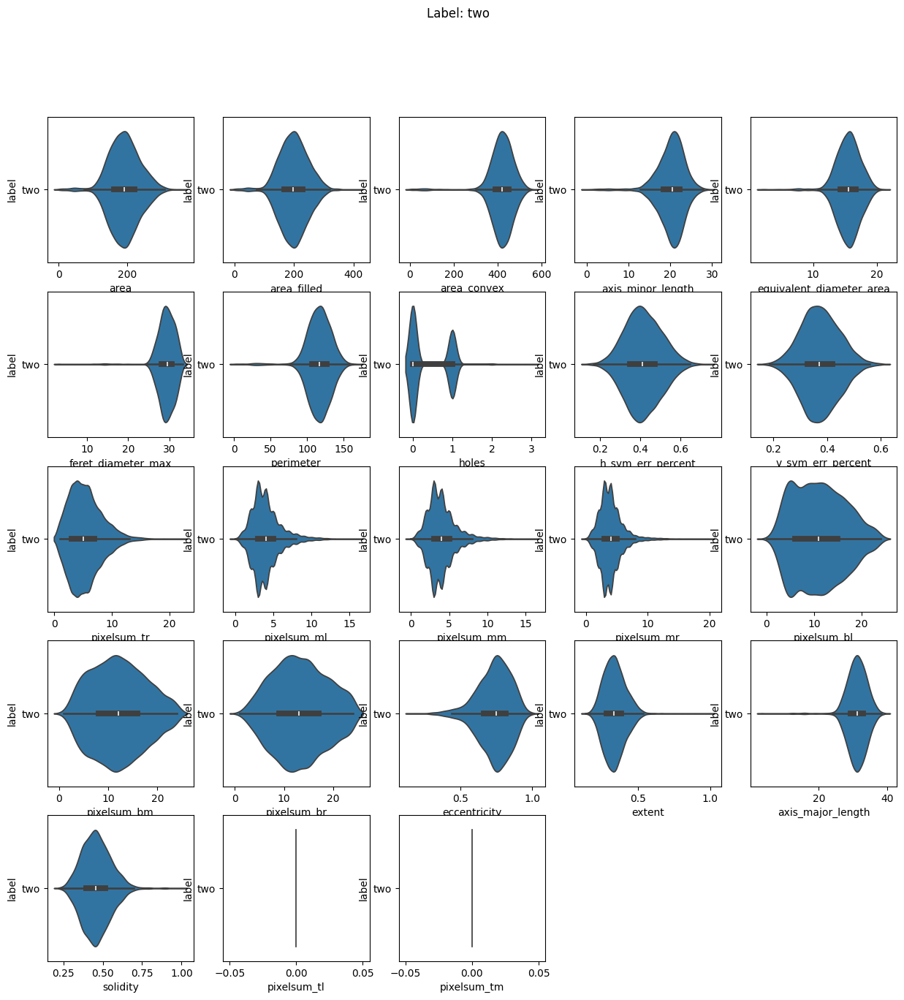

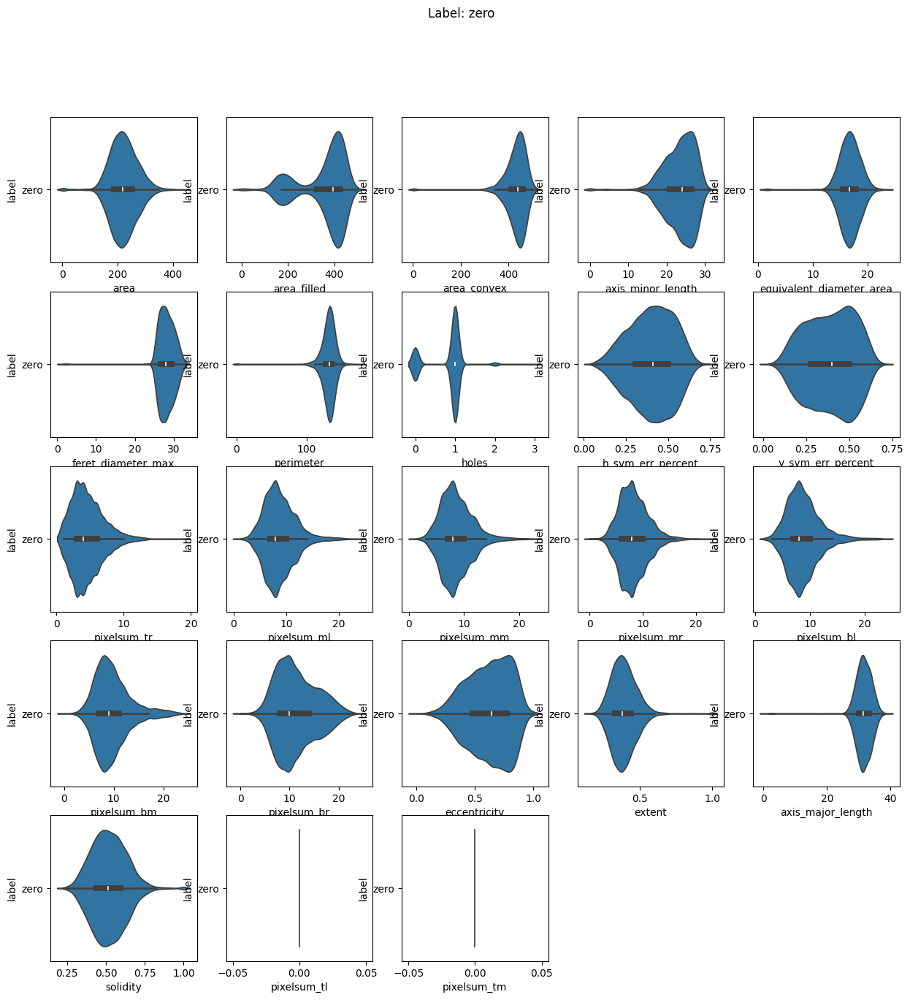

In [15]:
for i, (label, image_set) in enumerate(dataset.groupby('label')):
    fig, axs = plt.subplots(5, 5, figsize=(15, 15))
    fig.suptitle(f'Label: {label}')

    sns.violinplot(data=image_set, x='area', y='label', ax=axs[0, 0])
    sns.violinplot(data=image_set, x='area_filled', y='label', ax=axs[0, 1])
    sns.violinplot(data=image_set, x='area_convex', y='label', ax=axs[0, 2])
    sns.violinplot(data=image_set, x='axis_minor_length', y='label', ax=axs[0, 3])
    sns.violinplot(data=image_set, x='equivalent_diameter_area', y='label', ax=axs[0, 4])

    sns.violinplot(data=image_set, x='feret_diameter_max', y='label', ax=axs[1, 0])
    sns.violinplot(data=image_set, x='perimeter', y='label', ax=axs[1, 1])
    sns.violinplot(data=image_set, x='holes', y='label', ax=axs[1, 2])
    sns.violinplot(data=image_set, x='h_sym_err_percent', y='label', ax=axs[1, 3])
    sns.violinplot(data=image_set, x='v_sym_err_percent', y='label', ax=axs[1, 4])

    sns.violinplot(data=image_set, x='pixelsum_tr', y='label', ax=axs[2, 0])
    sns.violinplot(data=image_set, x='pixelsum_ml', y='label', ax=axs[2, 1])
    sns.violinplot(data=image_set, x='pixelsum_mm', y='label', ax=axs[2, 2])
    sns.violinplot(data=image_set, x='pixelsum_mr', y='label', ax=axs[2, 3])
    sns.violinplot(data=image_set, x='pixelsum_bl', y='label', ax=axs[2, 4])

    sns.violinplot(data=image_set, x='pixelsum_bm', y='label', ax=axs[3, 0])
    sns.violinplot(data=image_set, x='pixelsum_br', y='label', ax=axs[3, 1])
    sns.violinplot(data=image_set, x='eccentricity', y='label', ax=axs[3, 2])
    sns.violinplot(data=image_set, x='extent', y='label', ax=axs[3, 3])
    sns.violinplot(data=image_set, x='axis_major_length', y='label', ax=axs[3, 4])

    sns.violinplot(data=image_set, x='solidity', y='label', ax=axs[4, 0])
    sns.violinplot(data=image_set, x='pixelsum_tl', y='label', ax=axs[4, 1])
    sns.violinplot(data=image_set, x='pixelsum_tm', y='label', ax=axs[4, 2])
    
    # remove the last two plots
    axs[4, 3].axis('off')
    axs[4, 4].axis('off')
    plt.show()